# Análisis Exploratorio de Datos

## Importación de librerias

In [3]:
#Importamos las librerias necesarias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
from matplotlib import cm
from matplotlib.colors import ListedColormap
import warnings
warnings.filterwarnings("ignore")

## Configuración visual

In [4]:
#Configuración visual
plt.style.use('seaborn-v0_8')
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (12, 4)
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

viridis = cm.get_cmap('viridis', 256)
magma = cm.get_cmap('magma', 256)
plasma = cm.get_cmap('plasma', 256)

## Carga de archivos

In [5]:
# Cargamos el archivo limpio de Airbnb Barcelona
df = pd.read_csv(r'data\limpio_airbnb_Barcelona.csv')

In [ ]:
# Cargamos el archivo de licencias turísticas de Barcelona (fuente: Datos gobierno españa)
df2 = pd.read_csv(r'data\datos vivienda turistica bcn oficiales.csv')

In [25]:
# Cargamos el archivo de la evolución del precio de la vivienda y el alquiler en Barcelona (fuente: Idealista)
df3 = pd.read_csv(r'data\housing_prices_barcelona_2015_2025.csv')

In [8]:
#Leemos el archivo y comprobamos que se haya subido correctamente
df.head(2)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,fecha_inicio_host,tiempo_como_anfitrion,distancia_centro_km,categoria_precio,reviews_norm,rating_norm,indice_popularidad,rendimiento_economico,rendimiento_economico_mensual,categoria_distancia_centro
0,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia Maria,Eixample,la Sagrada Família,41.405560,2.17262,Entire home/apt,179.0,...,1900-01-01,NaN,2.069639,caro,0.014558,0.003918,0.011366,55.49,1664.7,media
1,23197,"Forum CCIB DeLuxe, Spacious, Large Balcony, relax",90417,Etain (Marnie),Sant Martí,el Besòs i el Maresme,41.412432,2.21975,Entire home/apt,251.0,...,2025-01-03,0.473648,5.079939,caro,0.026529,0.006067,0.020390,120.48,3614.4,lejos


In [18]:
#Leemos el archivo y comprobamos que se haya subido correctamente
df2.head(2)

,N_EXPEDIENT,CODI_DISTRICTE,NOM_DISTRICTE,CODI_BARRI,NOM_BARRI,TIPUS_CARRER,CARRER,TIPUS_NUM,NUM1,LLETRA1,...,LLETRA2,BLOC,PORTAL,ESCALA,PIS,PORTA,NUMERO_REGISTRE_GENERALITAT,NUMERO_PLACES,LONGITUD_X,LATITUD_Y
0,01-2009-0354,1,CIUTAT VELLA,1.0,el Raval,Carrer,SANT JOSEP ORIOL,1,19,NaN,...,NaN,NaN,NaN,NaN,01,1,HUTB-002222,3.0,"2,17017206787341","41,3784454355655"
1,01-2011-0123,1,CIUTAT VELLA,4.0,"Sant Pere, Santa Caterina i la Ribera",Carrer,AGULLERS,2,22,NaN,...,NaN,NaN,NaN,NaN,1,NaN,HUTB-003654,3.0,"2,18200417667745","41,3828840594187"


In [26]:
df3.head(2)

,Year,Avg_Purchase_Price_EUR_m2,Avg_Rental_Price_EUR_month
0,2015,3000,960.0
1,2016,3120,1000.0


## Análisis

### 1. Número de Airbnb en la ciudad de Barcelona

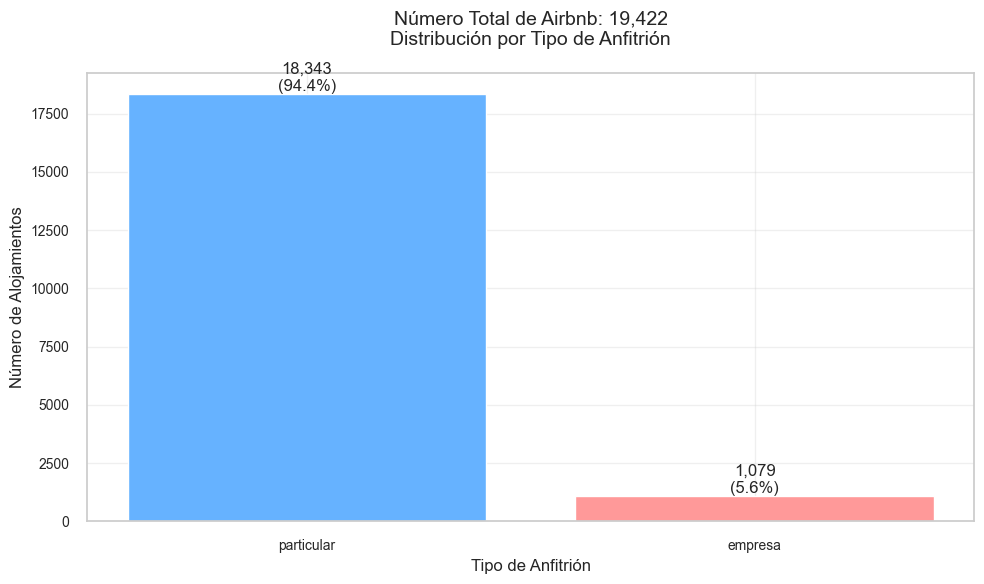

In [48]:
# Count the number of listings by host type
host_type_counts = df['tipo_anfitrion'].value_counts()
total_listings = len(df)

# Create the plot
plt.figure(figsize=(10, 6))

# Create bar plot
bars = plt.bar(host_type_counts.index, host_type_counts.values, color=['#66B2FF', '#FF9999'])

# Add title and labels
plt.title(f'Número Total de Airbnb: {total_listings:,}\nDistribución por Tipo de Anfitrión', pad=20, fontsize=14)
plt.xlabel('Tipo de Anfitrión', fontsize=12)
plt.ylabel('Número de Alojamientos', fontsize=12)

# Add value labels on top of each bar
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height):,}\n({height/total_listings*100:.1f}%)',
             ha='center', va='bottom')

# Add grid
plt.grid(True, alpha=0.3)

# Adjust layout
plt.tight_layout()

plt.show()


El gráfico muestra la distribución de los 19,422 alojamientos de Airbnb que se encuentran actualmente en la ciudad de Barcelona. De este total, el 94.4% (18.343), pertenecen a anfitriones individuales que no forman parte de una empresa.

Conclusión: El mercado de AirBnb en la ciudad de Barcelona depende en gran medida de proveedores individuales en lugar de entidades corporativas.

### 2.Tipos de Airbnb en la ciudad de Barcelona

<Figure size 1200x700 with 0 Axes>

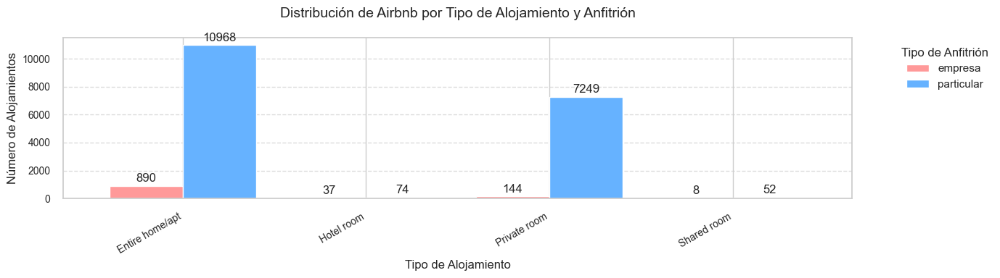

In [10]:
# Group the data by room type and host type
room_type_counts = df.groupby(['room_type', 'tipo_anfitrion']).size().unstack()

# Create figure and axis with larger size
plt.figure(figsize=(12, 7))

# Create the bar plot with a softer color palette
colors = ['#FF9999', '#66B2FF']
ax = room_type_counts.plot(kind='bar', width=0.8, color=colors)

# Customize the plot
plt.title('Distribución de Airbnb por Tipo de Alojamiento y Anfitrión', pad=20, fontsize=14)
plt.xlabel('Tipo de Alojamiento', fontsize=12)
plt.ylabel('Número de Alojamientos', fontsize=12)

# Add value labels on top of each bar with percentage
for i in ax.containers:
    ax.bar_label(i, label_type='edge', padding=2, fmt='%.0f')
    
# Rotate x-axis labels for better readability
plt.xticks(rotation=30, ha='right')

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout to prevent label cutoff
plt.tight_layout()

# Add legend with better placement
plt.legend(title='Tipo de Anfitrión', bbox_to_anchor=(1.05, 1), loc='upper left')

# Make the plot interactive
plt.show()

<Figure size 1200x600 with 0 Axes>

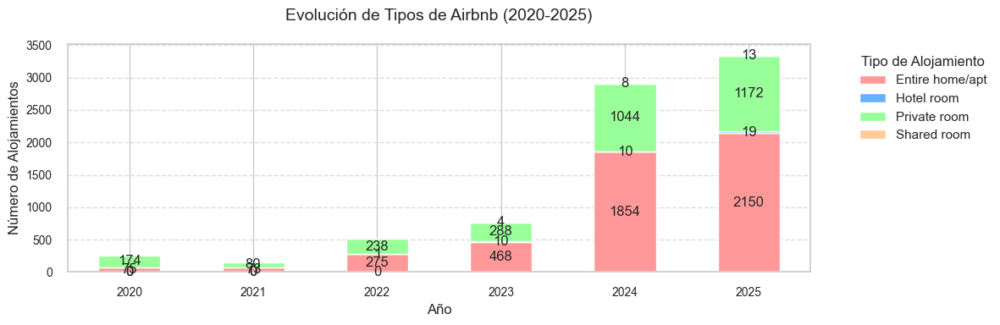

In [44]:
# Filter data from 2020 onwards
df_recent = df[df['year'] >= 2020]

# Create a pivot table of room types by year
room_type_by_year = pd.crosstab(df_recent['year'], df_recent['room_type'])

# Create the visualization
plt.figure(figsize=(12, 6))

# Create the stacked bar plot
ax = room_type_by_year.plot(kind='bar', stacked=True, 
                           color=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99'])

# Customize the plot
plt.title('Evolución de Tipos de Airbnb (2020-2025)', pad=20, fontsize=14)
plt.xlabel('Año', fontsize=12)
plt.ylabel('Número de Alojamientos', fontsize=12)

# Add value labels
for c in ax.containers:
    ax.bar_label(c, label_type='center')

# Rotate x-axis labels for better readability
plt.xticks(rotation=0)

# Add grid for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add legend with better placement
plt.legend(title='Tipo de Alojamiento', bbox_to_anchor=(1.05, 1))

# Adjust layout
plt.tight_layout()

plt.show()

Los anfitriones particulares son el pilar de Airbnb, gestionando la gran mayoría de los alojamientos, especialmente en "Entire home/apt" y "Private room".

Las empresas tienen una presencia limitada, destacando en "Hotel room" y "Shared room", pero con un impacto reducido en el total.

Conclusión: La evolución muestra un mercado en expansión, con un enfoque creciente en alojamientos completos gestionados por anfitriones particulares, lo que podría reflejar una demanda sostenida por este tipo de experiencia.

### 3. Año de creación del alojamiento

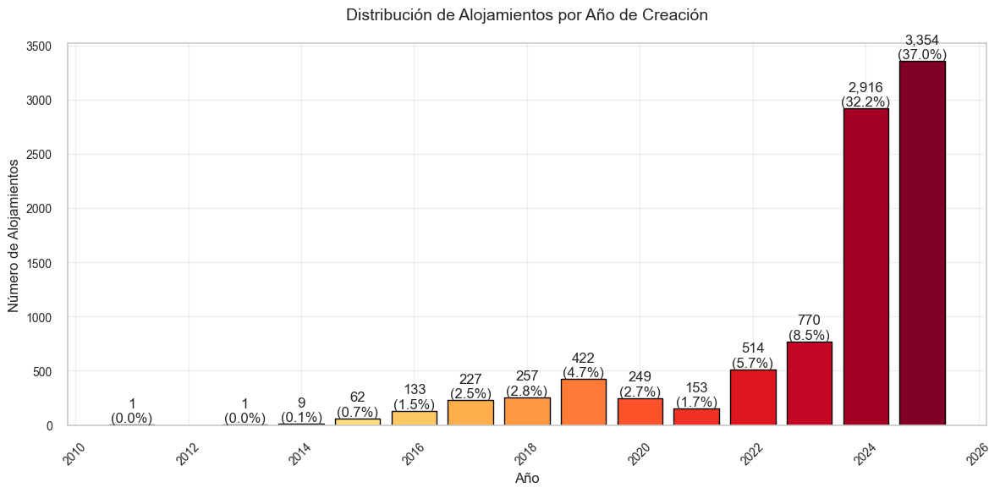

In [45]:
# Convert fecha_inicio_host to datetime and extract year
df['year'] = pd.to_datetime(df['fecha_inicio_host']).dt.year
# Add month to analyze trends
df['month'] = pd.to_datetime(df['fecha_inicio_host']).dt.month
df['year_month'] = pd.to_datetime(df['fecha_inicio_host']).dt.strftime('%Y-%m')

# Filter out years equal to 1900 (likely default values)
df_filtered = df[df['year'] != 1900]

# Count listings per year
yearly_counts = df_filtered['year'].value_counts().sort_index()

# Calculate percentages
percentages = (yearly_counts / yearly_counts.sum()) * 100

# Create the plot
plt.figure(figsize=(12, 6))

# Create colormap that transitions from yellow to red
colors = plt.cm.YlOrRd(np.linspace(0, 1, len(yearly_counts)))

# Create bar plot with color gradient
bars = plt.bar(yearly_counts.index, yearly_counts.values, 
               color=colors, edgecolor='black')

# Add value and percentage labels on top of each bar
for bar, percentage in zip(bars, percentages):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height):,}\n({percentage:.1f}%)',
             ha='center', va='bottom')

# Customize the plot
plt.title('Distribución de Alojamientos por Año de Creación', pad=20)
plt.xlabel('Año')
plt.ylabel('Número de Alojamientos')

# Add grid
plt.grid(True, alpha=0.3)

# Rotate x-axis labels
plt.xticks(rotation=45)

# Adjust layout
plt.tight_layout()

plt.show()

Años iniciales (2010-2016): Crecimiento lento con muy pocos alojamientos (1 en 2010 y 2012, 9 en 2014, 62 en 2016), representando menos del 1% al 1.5% del total.

2018: Aumento notable a 297 alojamientos (2.5%), marcando el inicio de un crecimiento más significativo.

2020: Sube a 422 alojamientos (4.7%), indicando una aceleración en la creación.

2022: Alcanza 514 alojamientos (5.7%), consolidando el crecimiento.

2024: Salto a 770 alojamientos (8.7%), reflejando una tendencia al alza.

2025: Pico con 2,916 alojamientos (32.2%) y 3,354 (37.4%), mostrando un aumento exponencial reciente.

Conclusión: La mayoría de los alojamientos (69.6%) se crearon en 2024 y 2025, sugiriendo un mercado que ha experimentado un crecimiento masivo en los últimos dos años.

### 4. Análisis del precio vivienda

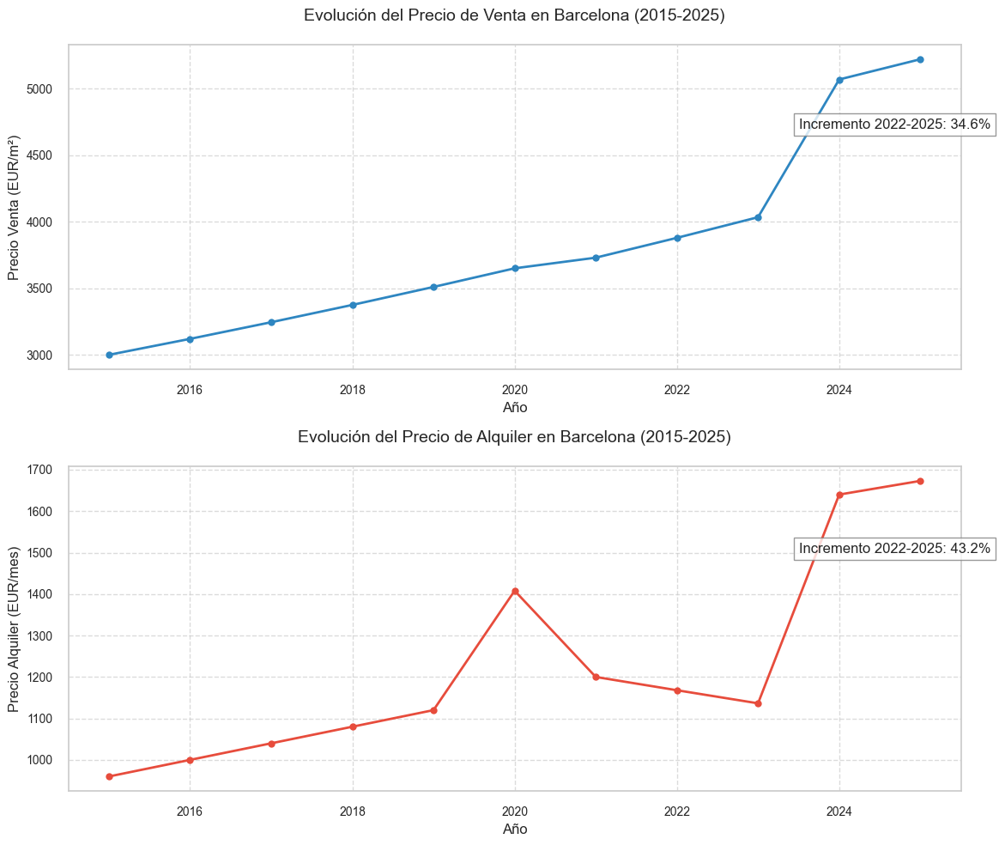

In [31]:
# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12, 10))

# Plot 1: Housing Price Evolution
ax1.plot(df3['Year'], df3['Avg_Purchase_Price_EUR_m2'], marker='o', linewidth=2, color='#2E86C1')
ax1.set_title('Evolución del Precio de Venta en Barcelona (2015-2025)', pad=20)
ax1.set_xlabel('Año')
ax1.set_ylabel('Precio Venta (EUR/m²)')
ax1.grid(True, linestyle='--', alpha=0.7)

# Calculate and show percentage increase from 2022 to 2025 for housing prices
price_2022 = df3[df3['Year'] == 2022]['Avg_Purchase_Price_EUR_m2'].values[0]
price_2025 = df3[df3['Year'] == 2025]['Avg_Purchase_Price_EUR_m2'].values[0]
price_increase_22_25 = ((price_2025 - price_2022) / price_2022) * 100

# Add percentage annotation for housing prices
ax1.annotate(f'Incremento 2022-2025: {price_increase_22_25:.1f}%',
             xy=(2023.5, 4500),
             xytext=(2023.5, 4700),
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.8))

# Plot 2: Rental Price Evolution
ax2.plot(df3['Year'], df3['Avg_Rental_Price_EUR_month'], marker='o', linewidth=2, color='#E74C3C')
ax2.set_title('Evolución del Precio de Alquiler en Barcelona (2015-2025)', pad=20)
ax2.set_xlabel('Año')
ax2.set_ylabel('Precio Alquiler (EUR/mes)')
ax2.grid(True, linestyle='--', alpha=0.7)

# Calculate and show percentage increase from 2022 to 2025 for rental prices
rent_2022 = df3[df3['Year'] == 2022]['Avg_Rental_Price_EUR_month'].values[0]
rent_2025 = df3[df3['Year'] == 2025]['Avg_Rental_Price_EUR_month'].values[0]
rent_increase_22_25 = ((rent_2025 - rent_2022) / rent_2022) * 100

# Add percentage annotation for rental prices
ax2.annotate(f'Incremento 2022-2025: {rent_increase_22_25:.1f}%',
             xy=(2023.5, 1400),
             xytext=(2023.5, 1500),
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.8))

plt.tight_layout()
plt.show()

Evolución del Precio de Venta

2024-2025: Sube a cerca de 5,000 €/m², con un incremento del 34% entre 2022 y 2025.

Tendencia: Crecimiento constante y significativo, con un fuerte impulso en los últimos años.

Evolución del Precio de Alquiler

2024-2025: Sube a cerca de 1,700 €/mes, con un incremento del 43% entre 2022 y 2025.

Tendencia: Crecimiento inicial, una caída temporal en 2022, y un fuerte repunte reciente.

Conclusión: Ambos mercados (venta y alquiler) han experimentado un aumento notable desde 2022, con el alquiler mostrando un crecimiento porcentual mayor (43%) que la venta (34%).

La vivienda en Barcelona se ha encarecido significativamente en los últimos años, reflejando una posible presión en la demanda o limitaciones en la oferta.

### 5. Rendimiento económico mensual alojamientos

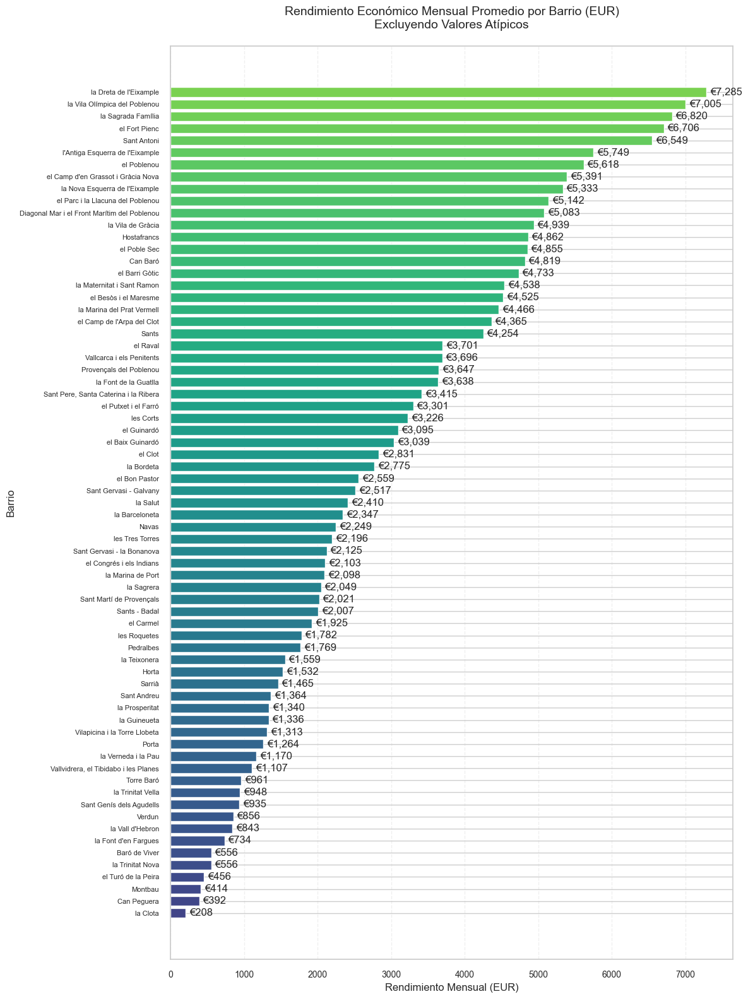

In [52]:
# Calculate average monthly economic performance by neighborhood
avg_performance = df.groupby('neighbourhood')['rendimiento_economico_mensual'].mean()

# Remove outliers using the IQR method
Q1 = avg_performance.quantile(0.25)
Q3 = avg_performance.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out outliers and sort values
avg_performance_filtered = avg_performance[
    (avg_performance >= lower_bound) & 
    (avg_performance <= upper_bound)
].sort_values(ascending=True)

# Create the plot
plt.figure(figsize=(12, 16))

# Create horizontal bars with a color gradient
colors = plt.cm.viridis(np.linspace(0.2, 0.8, len(avg_performance_filtered)))
bars = plt.barh(range(len(avg_performance_filtered)), avg_performance_filtered, color=colors)

# Customize the plot
plt.title('Rendimiento Económico Mensual Promedio por Barrio (EUR)\nExcluyendo Valores Atípicos', 
          pad=20, fontsize=14)
plt.xlabel('Rendimiento Mensual (EUR)', fontsize=12)
plt.ylabel('Barrio', fontsize=12)

# Add value labels with thousand separator and euro symbol
for i, v in enumerate(avg_performance_filtered):
    plt.text(v + 50, i, f'€{v:,.0f}', va='center')

# Set y-ticks with neighborhood names
plt.yticks(range(len(avg_performance_filtered)), avg_performance_filtered.index, fontsize=8)

# Add grid
plt.grid(True, axis='x', linestyle='--', alpha=0.3)

# Adjust layout
plt.tight_layout()

plt.show()

El barrio "la Dreta de l'Exemple" lidera con €7,285 mensuales, seguido por "la Vila Olímpica del Poblenou" con €7,005.

Distribución: La mayoría de los barrios oscilan entre €1,000 y €3,000 mensuales, con una concentración notable en el rango medio-alto (€3,000-€7,000).

Conclusión: Existen grandes disparidades en el rendimiento económico, con zonas turísticas o céntricas (como "la Dreta de l'Exemple") destacando, mientras que áreas periféricas (como "la Clota") ofrecen menores ingresos.

*** Observación: el precio medio del alquiler normal en la ciudad de barcelona ronda los 1.100 euros, llegando hasta los 1.600 euros en los barrios más céntricos como Sarrià o Les Corts. 

### 6. Vivienda turística por barrio

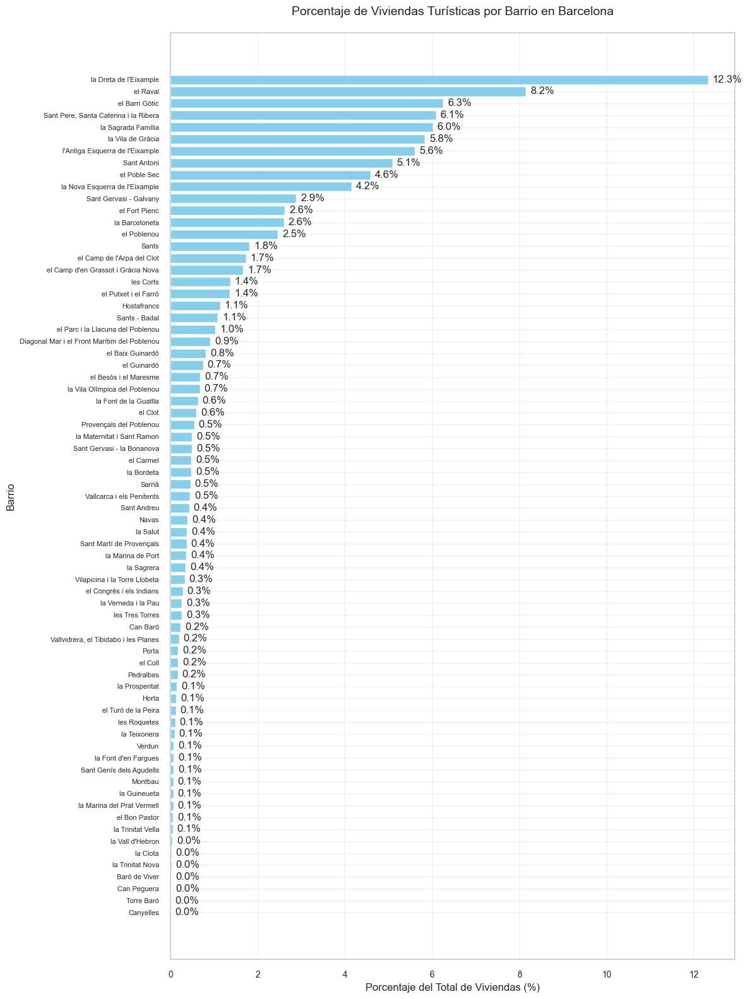

In [38]:
# Calculate the percentage of tourist accommodations by neighborhood
neighborhood_percentages = (df['neighbourhood'].value_counts() / len(df) * 100).sort_values(ascending=True)

# Create a horizontal bar plot
plt.figure(figsize=(12, 16))
bars = plt.barh(range(len(neighborhood_percentages)), neighborhood_percentages, color='skyblue')

# Customize the plot
plt.title('Porcentaje de Viviendas Turísticas por Barrio en Barcelona', pad=20)
plt.xlabel('Porcentaje del Total de Viviendas (%)')
plt.ylabel('Barrio')

# Add percentage labels
for i, v in enumerate(neighborhood_percentages):
    plt.text(v + 0.1, i, f'{v:.1f}%', va='center')

# Set y-ticks
plt.yticks(range(len(neighborhood_percentages)), neighborhood_percentages.index, fontsize=8)

# Add grid
plt.grid(True, alpha=0.3)

# Adjust layout
plt.tight_layout()

plt.show()

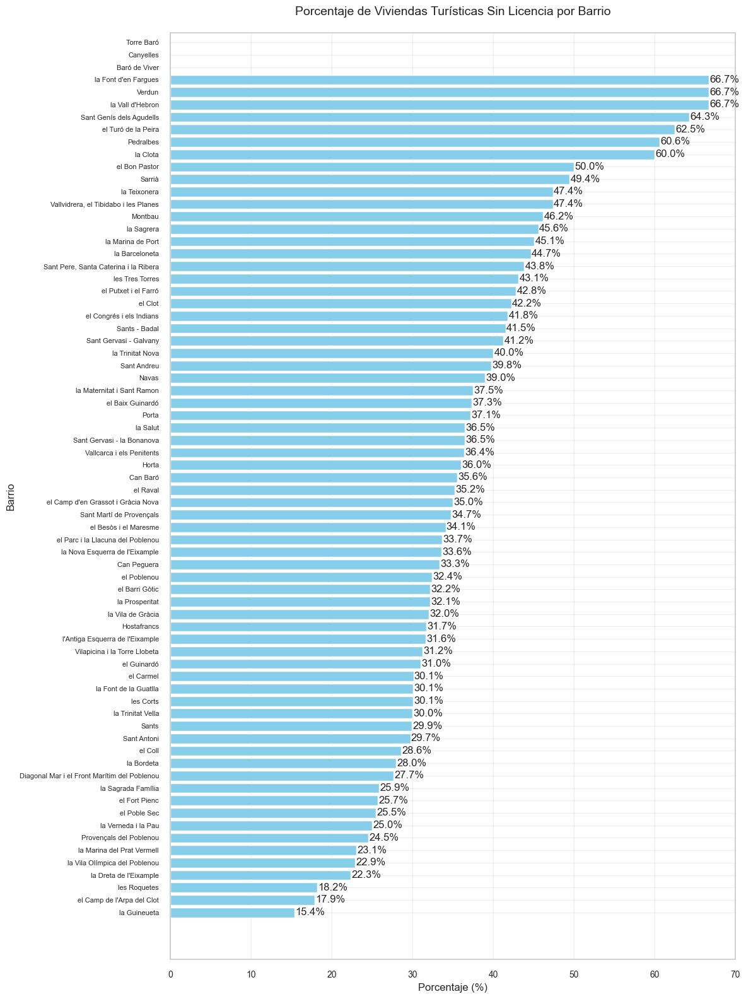

In [39]:
# Calculate the percentage of unlicensed accommodations by neighborhood
unlicensed_by_neighborhood = df[df['license'] == 'sin datos'].groupby('neighbourhood').size()
total_by_neighborhood = df.groupby('neighbourhood').size()
percentage_unlicensed = (unlicensed_by_neighborhood / total_by_neighborhood * 100).sort_values(ascending=True)

# Create the plot
plt.figure(figsize=(12, 16))

# Create horizontal bars
bars = plt.barh(range(len(percentage_unlicensed)), percentage_unlicensed, color='skyblue')

# Customize the plot
plt.title('Porcentaje de Viviendas Turísticas Sin Licencia por Barrio', pad=20)
plt.xlabel('Porcentaje (%)')
plt.ylabel('Barrio')

# Add percentage labels
for i, v in enumerate(percentage_unlicensed):
    plt.text(v + 0.1, i, f'{v:.1f}%', va='center')

# Set y-ticks
plt.yticks(range(len(percentage_unlicensed)), percentage_unlicensed.index, fontsize=8)

# Add grid
plt.grid(True, alpha=0.3)

# Adjust layout
plt.tight_layout()

plt.show()

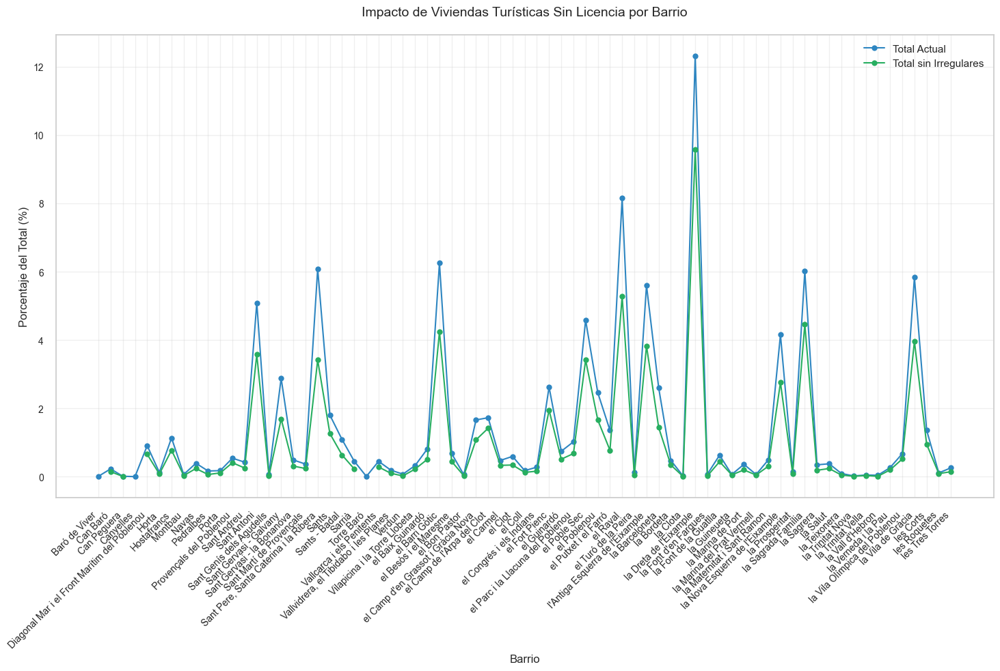

In [43]:
# Create a comparative DataFrame
comparison_df = pd.DataFrame({
    'Total (%)': total_percentages,
    'Sin Licencia (%)': percentage_unlicensed
})

# Calculate percentage after removing unlicensed
comparison_df['Con Licencia (%)'] = comparison_df['Total (%)'] * (1 - comparison_df['Sin Licencia (%)']/100)

# Create figure and axis
plt.figure(figsize=(15, 10))

# Plot lines
plt.plot(comparison_df.index, comparison_df['Total (%)'], marker='o', label='Total Actual', color='#2E86C1')
plt.plot(comparison_df.index, comparison_df['Con Licencia (%)'], marker='o', label='Total sin Irregulares', color='#27AE60')

# Customize the plot
plt.title('Impacto de Viviendas Turísticas Sin Licencia por Barrio', pad=20, fontsize=14)
plt.xlabel('Barrio', fontsize=12)
plt.ylabel('Porcentaje del Total (%)', fontsize=12)

# Rotate x-axis labels
plt.xticks(rotation=45, ha='right')

# Add grid
plt.grid(True, alpha=0.3)

# Add legend
plt.legend()

# Adjust layout
plt.tight_layout()

plt.show()

Porcentaje de Viviendas Turísticas por Barrio

Mayor concentración: "la Dreta de l'Exemple" lidera con un 12.3%, seguido por "el Raval" con 8.2% y "el Barri Gòtic" con 6.3%.

Zonas intermedias: Barrios como "la Ribera" (6.1%), "la Sagrada Família" (6.0%), y "Sant Antoni" (5.6%) muestran una presencia significativa de viviendas turísticas.

Baja incidencia: Barrios como "la Trinitat Vella" (0.0%), "la Clota" (0.0%), y "Montbau" (0.0%) tienen un porcentaje nulo o casi nulo.

Tendencia general: La mayoría de los barrios tienen menos del 5% de viviendas turísticas, con una concentración notable en áreas céntricas o turísticas.

Porcentaje de Viviendas Turísticas Sin Licencia por Barrio

Mayor irregularidad: "Vallvidrera, el Tibidabo i les Planes" destaca con un 66.7%, seguido por "la Font d'en Fargues" (66.7%) y "el Verdun" (60.6%).

Zonas intermedias: Barrios como "Pedralbes" (50.0%), "la Clota" (60.0%), y "el Bon Pastor" (47.4%) muestran altos niveles de irregularidad.

Baja irregularidad: Áreas como "la Dreta de l'Exemple" (22.9%) y "el Raval" (28.8%) tienen porcentajes más bajos, a pesar de su alta densidad de viviendas turísticas.

Tendencia general: La irregularidad es más pronunciada en barrios periféricos, mientras que las zonas turísticas céntricas tienden a tener una proporción menor de viviendas sin licencia.

Impacto de Viviendas Turísticas Sin Licencia por Barrio
Pico máximo: "Vallvidrera, el Tibidabo i les Planes" alcanza un impacto del 10% tanto en total actual como en irregularidades.

Variabilidad: Barrios como "la Dreta de l'Exemple" y "el Raval" muestran picos moderados (alrededor del 6-8%), mientras que áreas periféricas como "Montbau" o "la Clota" tienen impacto casi nulo.

Conclusión: El impacto de las viviendas sin licencia es mayor en zonas menos turísticas, sugiriendo una regulación más estricta en áreas centrales.

Observaciones Generales

Las zonas turísticas más populares (ej. "la Dreta de l'Exemple", "el Raval") tienen un alto porcentaje de viviendas turísticas, pero una menor proporción sin licencia, indicando una mejor regulación.

Los barrios periféricos presentan alta irregularidad, posiblemente debido a menor supervisión o menor demanda turística regulada.

El impacto general de las viviendas sin licencia es variable, con picos en áreas específicas que podrían requerir atención regulatoria.

### 7.Distribución de Airbnb según tipo de propietario

In [ ]:
# Create a base map centered on Barcelona
map_bcn_owner = folium.Map(location=[41.3887, 2.1589], zoom_start=12)

# Create separate feature groups for each type of owner
empresas = folium.FeatureGroup(name='Empresas (Rojo)')
particulares = folium.FeatureGroup(name='Particulares (Azul)')

# Add points for each type with different colors
for idx, row in df.iterrows():
    if row['tipo_anfitrion'] == 'empresa':
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Neighborhood: {row['neighbourhood']}",
            color='red',
            fill=True,
            fill_opacity=0.7
        ).add_to(empresas)
    else:
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Neighborhood: {row['neighbourhood']}",
            color='blue',
            fill=True,
            fill_opacity=0.7
        ).add_to(particulares)

# Calculate statistics
total_companies = len(df[df['tipo_anfitrion'] == 'empresa'])
total_individuals = len(df[df['tipo_anfitrion'] == 'particular'])
total_listings = len(df)

# Add legend with total counts
legend_html = f'''
    <div style="position: fixed; 
    bottom: 50px; left: 50px; width: 300px; height: 120px; 
    border:2px solid grey; z-index:9999; font-size:14px;
    background-color:white;
    padding: 10px;
    ">
    <p><strong>Leyenda</strong></p>
    <p>
    <i class="fa fa-circle fa-1x" style="color:red"></i> Empresas ({total_companies}, {(total_companies/total_listings)*100:.1f}%)<br>
    <i class="fa fa-circle fa-1x" style="color:blue"></i> Particulares ({total_individuals}, {(total_individuals/total_listings)*100:.1f}%)<br>
    Total: {total_listings}
    </p>
    </div>
    '''
map_bcn_owner.get_root().html.add_child(folium.Element(legend_html))

# Add both feature groups to the map
empresas.add_to(map_bcn_owner)
particulares.add_to(map_bcn_owner)

# Add layer control
folium.LayerControl().add_to(map_bcn_owner)

# Display the map
map_bcn_owner

### 8. Distribución de airbnb sin datos de licencia

In [ ]:
# First, ensure coordinates in both dataframes are in correct format
df2['LATITUD_Y'] = df2['LATITUD_Y'].astype(float)
df2['LONGITUD_X'] = df2['LONGITUD_X'].astype(float)

# Calculate statistics
unlicensed_companies = len(df[(df['license'] == 'sin datos') & (df['tipo_anfitrion'] == 'empresa')])
unlicensed_individuals = len(df[(df['license'] == 'sin datos') & (df['tipo_anfitrion'] == 'particular')])
unlicensed_count = unlicensed_companies + unlicensed_individuals
company_percentage = (unlicensed_companies / unlicensed_count) * 100
individual_percentage = (unlicensed_individuals / unlicensed_count) * 100

# Create a base map centered on Barcelona
map_bcn_no_license = folium.Map(location=[41.3887, 2.1589], zoom_start=12)

# Create separate feature groups for each type of owner
empresas_sin_licencia = folium.FeatureGroup(name='Empresas sin licencia (Rojo)')
particulares_sin_licencia = folium.FeatureGroup(name='Particulares sin licencia (Azul)')

# Create a set of tuples with coordinates from df2 (licensed properties)
licensed_coords = set(zip(df2['LATITUD_Y'], df2['LONGITUD_X']))

# Function to check if coordinates are close (within 50 meters)
def coords_match(lat1, lon1, licensed_coords, threshold=0.0005):
    for lat2, lon2 in licensed_coords:
        if abs(lat1 - lat2) < threshold and abs(lon1 - lon2) < threshold:
            return True
    return False

# Add points for properties without license and not in official database
for idx, row in df[df['license'] == 'sin datos'].iterrows():
    if not coords_match(row['latitude'], row['longitude'], licensed_coords):
        if row['tipo_anfitrion'] == 'empresa':
            folium.CircleMarker(
                location=[row['latitude'], row['longitude']],
                radius=3,
                popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Host: {row['tipo_anfitrion']}",
                color='red',
                fill=True,
                fill_opacity=0.7
            ).add_to(empresas_sin_licencia)
        else:
            folium.CircleMarker(
                location=[row['latitude'], row['longitude']],
                radius=3,
                popup=f"Price: €{row['price']}<br>Type: {row['room_type']}<br>Host: {row['tipo_anfitrion']}",
                color='blue',
                fill=True,
                fill_opacity=0.7
            ).add_to(particulares_sin_licencia)

# Create legend with statistics
legend_html = f'''
     <div style="position: fixed; 
     bottom: 50px; left: 50px; width: 300px; height: 120px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white;
     padding: 10px;
     ">
     <p><strong>Leyenda</strong></p>
     <p>
     <i class="fa fa-circle fa-1x" style="color:red"></i> Empresas sin licencia ({unlicensed_companies}, {company_percentage:.1f}%)<br>
     <i class="fa fa-circle fa-1x" style="color:blue"></i> Particulares sin licencia ({unlicensed_individuals}, {individual_percentage:.1f}%)<br>
     Total sin licencia: {unlicensed_count}
     </p>
     </div>
     '''

map_bcn_no_license.get_root().html.add_child(folium.Element(legend_html))

# Add feature groups to the map
empresas_sin_licencia.add_to(map_bcn_no_license)
particulares_sin_licencia.add_to(map_bcn_no_license)

# Add layer control
folium.LayerControl().add_to(map_bcn_no_license)

# Display the map
map_bcn_no_license

6.222 alojaminetos de Airbnb no cuentan con licencia (datos contrastados los datos proporcionado por el gobierno de españa sobre las licencias turísticas de Barcelona) 

El 32.03% de los alojamientos turísticos anunciados en AirBnb en la ciudad de Barcelona no cuentan con licencia turística (o está en trámite), por lo que son 
ilegales.

### 9. Anfitriones sin licencia turística

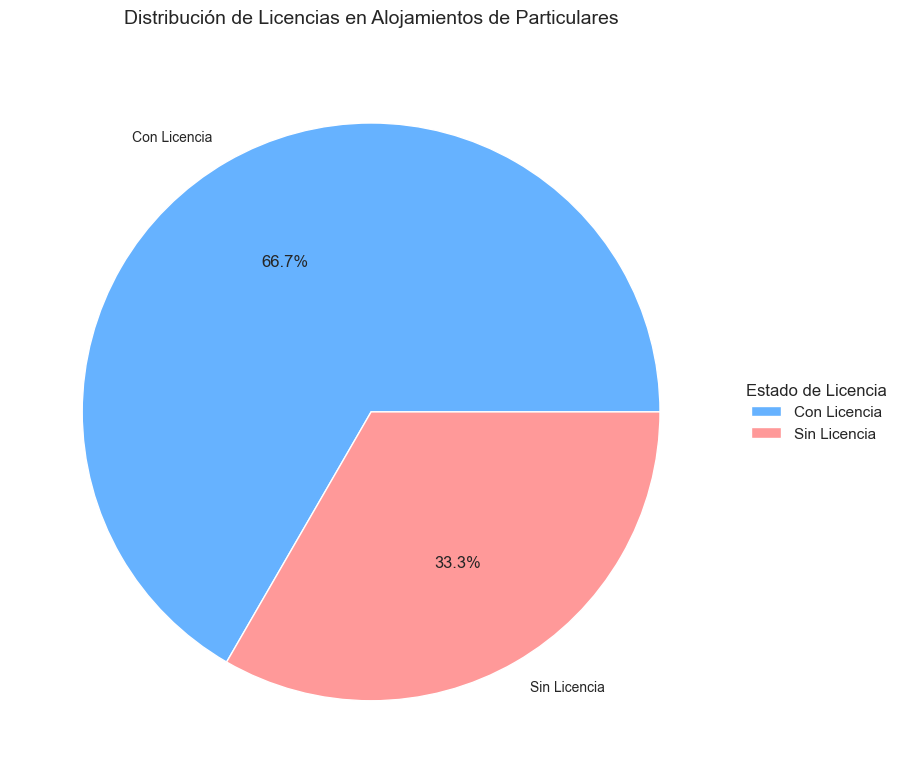

In [ ]:
# Calculate percentages of unlicensed properties by host type
unlicensed_particulares = df[(df['license'] == 'sin datos') & (df['tipo_anfitrion'] == 'particular')]
total_particulares = df[df['tipo_anfitrion'] == 'particular']

# Calculate statistics
total_count = len(total_particulares)
unlicensed_count = len(unlicensed_particulares)
licensed_count = total_count - unlicensed_count

percentages = [
    (licensed_count/total_count) * 100,
    (unlicensed_count/total_count) * 100
]

labels = ['Con Licencia', 'Sin Licencia']
colors = ['#66B2FF', '#FF9999']

# Create the pie chart
plt.figure(figsize=(10, 8))
plt.pie(percentages, labels=labels, colors=colors, autopct='%1.1f%%',
        wedgeprops={'edgecolor': 'white'})

plt.title('Distribución de Licencias en Alojamientos de Particulares', pad=20)

# Add a legend
plt.legend(labels, title="Estado de Licencia",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))

plt.tight_layout()
plt.show()

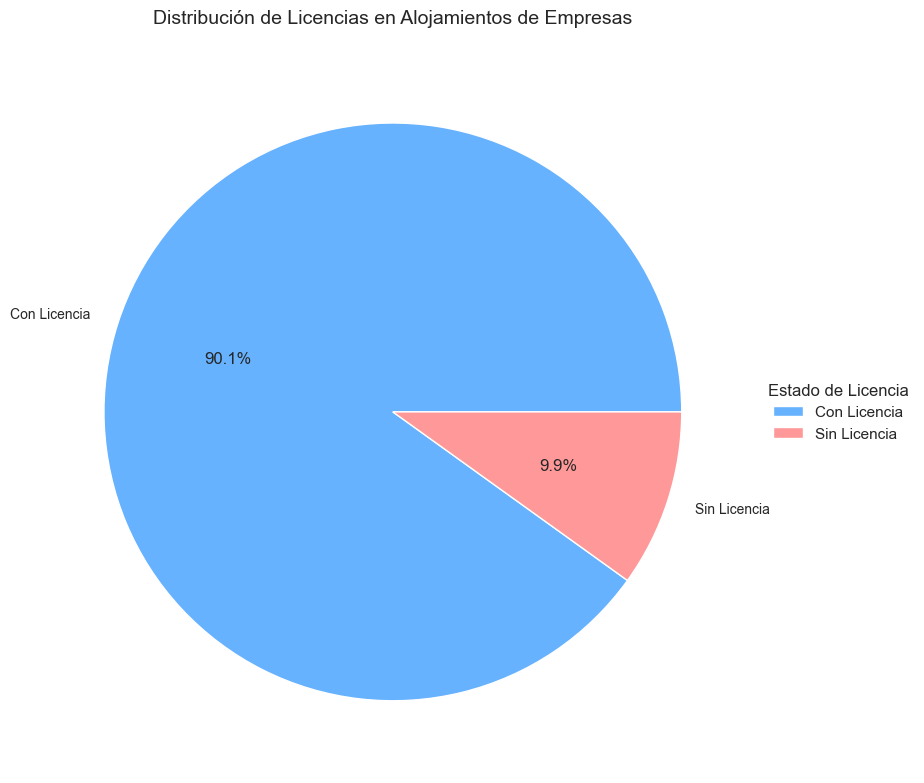

In [54]:
# Calculate total business hosts without license
empresas_sin_licencia = df[(df['tipo_anfitrion'] == 'empresa') & (df['license'] == 'sin datos')]
total_empresas = df[df['tipo_anfitrion'] == 'empresa']

# Calculate percentages
total_count = len(total_empresas)
unlicensed_count = len(empresas_sin_licencia)
licensed_count = total_count - unlicensed_count

percentages = [
    (licensed_count/total_count) * 100,
    (unlicensed_count/total_count) * 100
]

labels = ['Con Licencia', 'Sin Licencia']
colors = ['#66B2FF', '#FF9999']

# Create the pie chart
plt.figure(figsize=(10, 8))
plt.pie(percentages, labels=labels, colors=colors, autopct='%1.1f%%',
        wedgeprops={'edgecolor': 'white'})

plt.title('Distribución de Licencias en Alojamientos de Empresas', pad=20)

# Add a legend
plt.legend(labels, title="Estado de Licencia",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))

plt.tight_layout()
plt.show()

El 33.3% de los particulares opera sin licencia turística.

El 9.9% de los empresarios opera sin licencia turística.

Diferencia de Cumplimiento: Las empresas tienen un 24.1% más de alojamientos con licencia que los particulares (90.1% vs. 66%), lo que sugiere una mayor adherencia a la regulación por parte de las empresas.

Impacto Potencial: Si se eliminan las viviendas sin licencia, los particulares perderían un 33% de su oferta (aproximadamente 6,043 de 18,343 alojamientos, basados en el total de 18,343 particulares), mientras que las empresas perderían solo un 9.9% (unos 107 de 1,079 alojamientos).